Adopted from: https://www.kaggle.com/code/farzadnekouei/imbalanced-garbage-classification-resnet50#Step-4-%7C-Addressing-Dataset-Imbalances

In [1]:
import warnings
warnings.filterwarnings('ignore')

import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
from PIL import Image
from sklearn.model_selection import train_test_split
from sklearn.utils.class_weight import compute_class_weight
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.layers import Input, Activation, Add, Dense, Conv2D, GlobalAveragePooling2D, MaxPooling2D
from keras.layers import BatchNormalization, Dropout
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input
from tensorflow.keras.optimizers import Adam
from keras.callbacks import ReduceLROnPlateau, EarlyStopping
from keras.models import Model
from keras.utils import plot_model
from sklearn.metrics import classification_report, confusion_matrix

In [2]:
dataset_path = "D:\\Study\\resics_applied_ml_project\\data\\NWPU-RESISC45"
picture_types = os.listdir(dataset_path)
all_dimensions_set = set()

In [3]:
print(picture_types)

['airplane', 'airport', 'baseball_diamond', 'basketball_court', 'beach', 'bridge', 'chaparral', 'church', 'circular_farmland', 'cloud', 'commercial_area', 'dense_residential', 'desert', 'forest', 'freeway', 'golf_course', 'ground_track_field', 'harbor', 'industrial_area', 'intersection', 'island', 'lake', 'meadow', 'medium_residential', 'mobile_home_park', 'mountain', 'overpass', 'palace', 'parking_lot', 'railway', 'railway_station', 'rectangular_farmland', 'river', 'roundabout', 'runway', 'sea_ice', 'ship', 'snowberg', 'sparse_residential', 'stadium', 'storage_tank', 'tennis_court', 'terrace', 'thermal_power_station', 'wetland']


In [4]:
for picture_type in picture_types:
    folder_path = os.path.join(dataset_path, picture_type)
    if os.path.isdir(folder_path):
      image_files = [f for f in os.listdir(folder_path) if f.endswith(('.png', '.jpg', '.jpeg'))]
      num_images = len(image_files)
      print(f"{picture_type} folder contains {num_images} images.")

      for image_file in image_files:
        image_path = os.path.join(folder_path, image_file)
        with Image.open(image_path) as img:
          width, height = img.size
          channels = len(img.getbands())
          all_dimensions_set.add((width, height, channels))

if len(all_dimensions_set) == 1:
  width, height, channels = all_dimensions_set.pop()
  print(f"All images have the same dimensions: {width} * {height} with {channels} color channels")
else:
  print("Images have different dimensions.")

airplane folder contains 700 images.
airport folder contains 700 images.
baseball_diamond folder contains 700 images.
basketball_court folder contains 700 images.
beach folder contains 700 images.
bridge folder contains 700 images.
chaparral folder contains 700 images.
church folder contains 700 images.
circular_farmland folder contains 700 images.
cloud folder contains 700 images.
commercial_area folder contains 700 images.
dense_residential folder contains 700 images.
desert folder contains 700 images.
forest folder contains 700 images.
freeway folder contains 700 images.
golf_course folder contains 700 images.
ground_track_field folder contains 700 images.
harbor folder contains 700 images.
industrial_area folder contains 700 images.
intersection folder contains 700 images.
island folder contains 700 images.
lake folder contains 700 images.
meadow folder contains 700 images.
medium_residential folder contains 700 images.
mobile_home_park folder contains 700 images.
mountain folder c

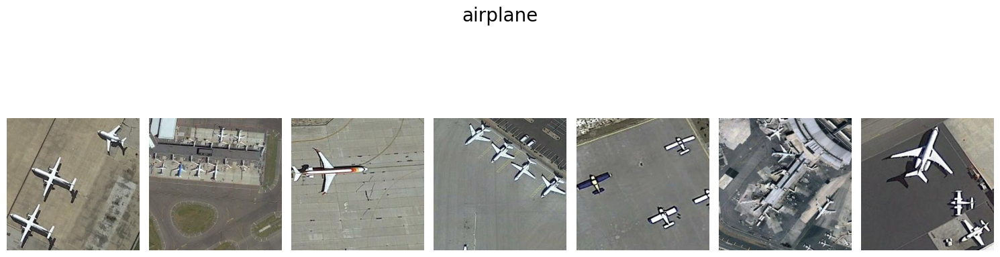

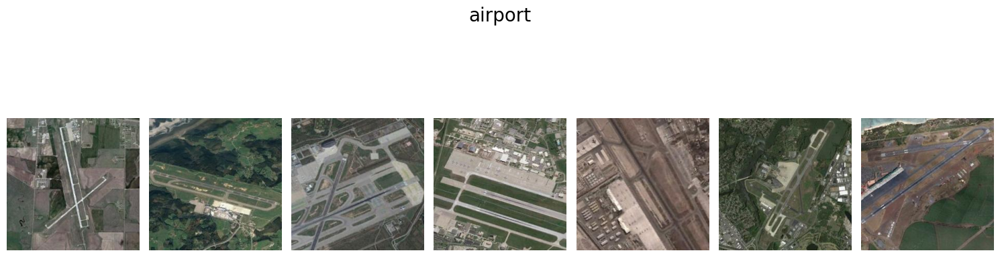

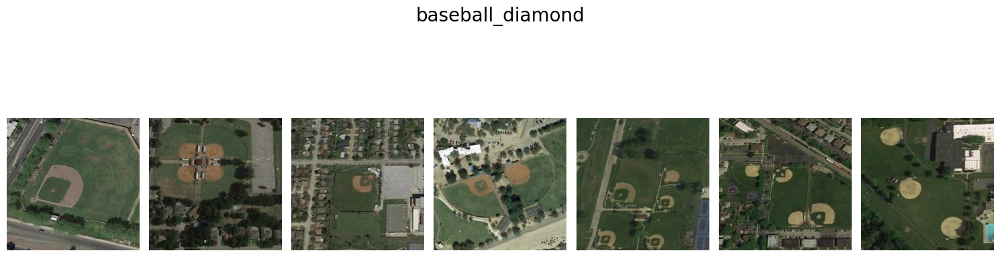

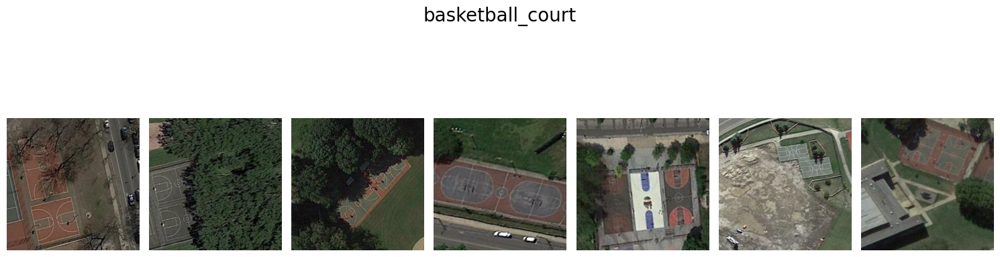

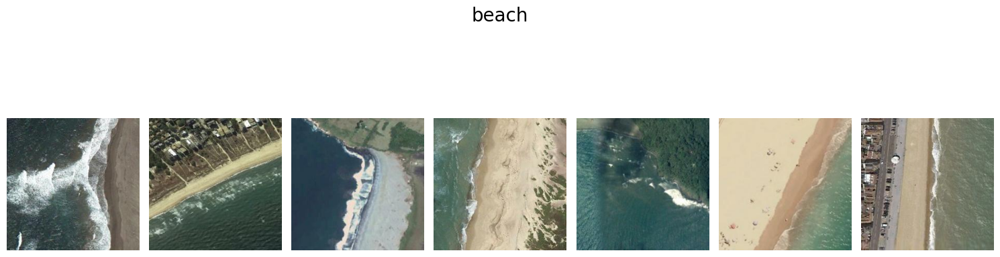

...

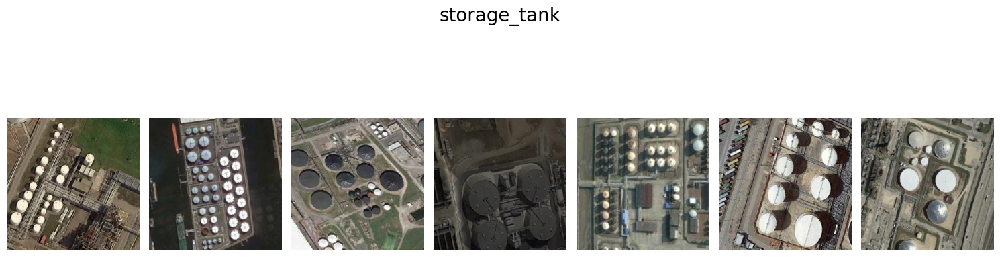

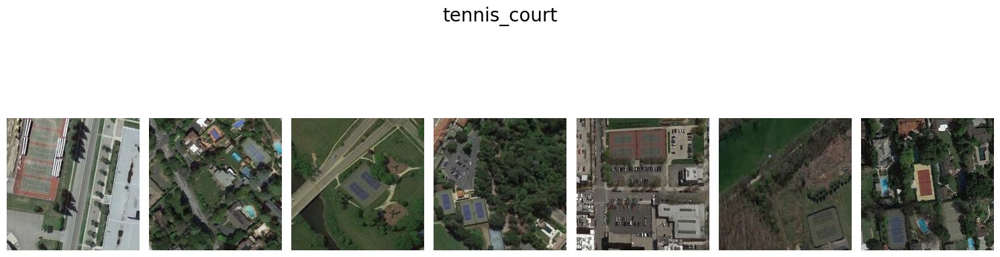

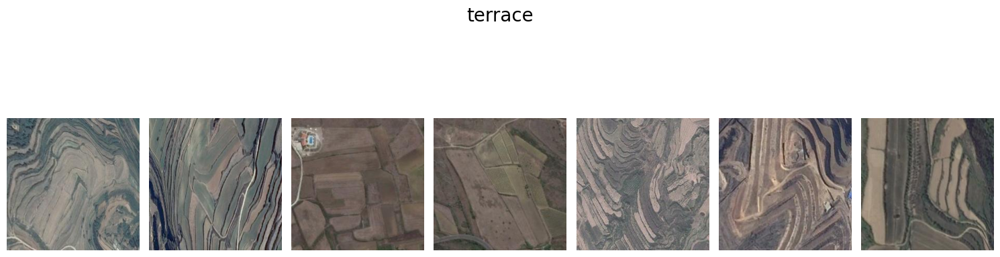

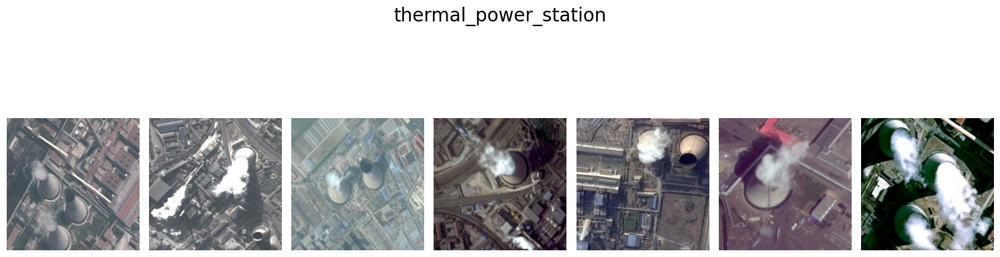

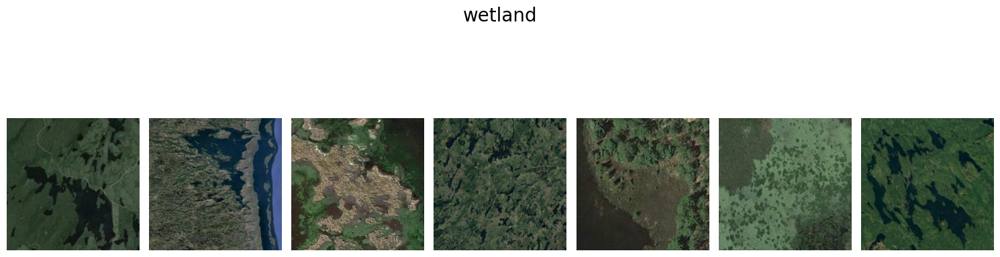

In [5]:
for picture_type in picture_types:
  folder_path = os.path.join(dataset_path, picture_type)
  if os.path.isdir(folder_path):
    image_files = [f for f in os.listdir(folder_path) if f.endswith(('.png', '.jpg', '.jpeg'))]
    image_files = image_files[:7]
    fig, axs = plt.subplots(1, 7, figsize=(15, 5))

    for i, image_file in enumerate(image_files):
      image_path = os.path.join(folder_path, image_file)
      with Image.open(image_path) as img:
        axs[i].imshow(img)
        axs[i].axis('off')

    plt.tight_layout()
    fig.suptitle(picture_type, fontsize = 20, y=1.03)
    plt.show()

In [6]:
data = []

for picture_type in picture_types:
  for file in os.listdir(os.path.join(dataset_path, picture_type)):
    data.append((os.path.join(dataset_path, picture_type, file), picture_type))

df = pd.DataFrame(data, columns=['path', 'type'])
df.head()

,path,type
0,D:\Study\resics_applied_ml_project\data\NWPU-R...,airplane
1,D:\Study\resics_applied_ml_project\data\NWPU-R...,airplane
2,D:\Study\resics_applied_ml_project\data\NWPU-R...,airplane
3,D:\Study\resics_applied_ml_project\data\NWPU-R...,airplane
4,D:\Study\resics_applied_ml_project\data\NWPU-R...,airplane


In [7]:
df.shape

(31500, 2)

In [8]:
train_df, val_df = train_test_split(df, test_size=0.2, random_state=42, stratify=df["type"])
print(f"Number of images in the training set: {len(train_df)}")
print(f"Number of images in the validation set: {len(val_df)}")

Number of images in the training set: 25200
Number of images in the validation set: 6300


In [9]:
class_labels = train_df['type'].unique()
class_labels

array(['sea_ice', 'bridge', 'palace', 'church', 'intersection',
       'roundabout', 'forest', 'cloud', 'tennis_court', 'industrial_area',
       'thermal_power_station', 'harbor', 'ground_track_field',
       'railway_station', 'overpass', 'ship', 'island', 'parking_lot',
       'dense_residential', 'runway', 'rectangular_farmland', 'chaparral',
       'mobile_home_park', 'storage_tank', 'commercial_area', 'wetland',
       'river', 'terrace', 'airport', 'stadium', 'baseball_diamond',
       'sparse_residential', 'medium_residential', 'desert', 'meadow',
       'freeway', 'railway', 'snowberg', 'mountain', 'basketball_court',
       'circular_farmland', 'beach', 'golf_course', 'airplane', 'lake'],
      dtype=object)

In [10]:
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(256, 256, 3))
base_model.summary()

Model: "resnet50"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, 262, 262,  │          0 │ input_layer[0][0] │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 128, 128,  │      9,472 │ conv1_pad[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 128, 128,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 128, 128,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, 130, 130,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, 64, 64,    │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 64, 64,    │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 64, 64,    │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 64, 64,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 64, 64,    │     36,928 │ conv2_block1_1_r… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_bn   │ (None, 64, 64,    │        256 │ conv2_block1_2_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_relu │ (None, 64, 64,    │          0 │ conv2_block1_2_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_conv │ (None, 64, 64,    │     16,640 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_conv │ (None, 64, 64,    │     16,640 │ conv2_block1_2_r… │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 64, 64,    │      1,024 │ conv2_block1_0_c… │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_bn   │ (None, 64, 64,    │      1,024 │ conv2_block1_3_c

 Total params: 23,587,712 (89.98 MB)

 Trainable params: 23,534,592 (89.78 MB)

 Non-trainable params: 53,120 (207.50 KB)

In [11]:
len(base_model.layers)

175

In [12]:
for i, layer in enumerate(base_model.layers):
    if 140 <= i <= 175:
        print(i, layer.name)

140 conv4_block6_3_bn
141 conv4_block6_add
142 conv4_block6_out
143 conv5_block1_1_conv
144 conv5_block1_1_bn
145 conv5_block1_1_relu
146 conv5_block1_2_conv
147 conv5_block1_2_bn
148 conv5_block1_2_relu
149 conv5_block1_0_conv
150 conv5_block1_3_conv
151 conv5_block1_0_bn
152 conv5_block1_3_bn
153 conv5_block1_add
154 conv5_block1_out
155 conv5_block2_1_conv
156 conv5_block2_1_bn
157 conv5_block2_1_relu
158 conv5_block2_2_conv
159 conv5_block2_2_bn
160 conv5_block2_2_relu
161 conv5_block2_3_conv
162 conv5_block2_3_bn
163 conv5_block2_add
164 conv5_block2_out
165 conv5_block3_1_conv
166 conv5_block3_1_bn
167 conv5_block3_1_relu
168 conv5_block3_2_conv
169 conv5_block3_2_bn
170 conv5_block3_2_relu
171 conv5_block3_3_conv
172 conv5_block3_3_bn
173 conv5_block3_add
174 conv5_block3_out


In [13]:
for layer in base_model.layers[:155]:
    layer.trainable = False

In [14]:
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dropout(0.5)(x)
x = Dense(45, activation='softmax')(x)

transfer_resnet50_model = Model(inputs=base_model.input, outputs=x)

transfer_resnet50_model.compile(optimizer=Adam(learning_rate=0.001), loss='categorical_crossentropy', metrics=['accuracy'])

In [15]:
train_datagen = ImageDataGenerator(
    rotation_range=60,
    width_shift_range=0.15,
    height_shift_range=0.15,
    zoom_range=0.20,
    horizontal_flip=True,
    vertical_flip=True,
    shear_range=0.05,
    brightness_range=[0.9, 1.1],
    channel_shift_range=10,
    fill_mode='nearest',
    preprocessing_function=preprocess_input
)

val_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

In [16]:
train_generator = train_datagen.flow_from_dataframe(
    dataframe=train_df,                  # DataFrame containing training data
    x_col="path",                    # Column with paths to image files
    y_col="type",                       # Column with image labels
    target_size=(256, 256),              # Resize all images to size of 384x384
    batch_size=32,                       # Number of images per batch
    class_mode='categorical',            # One-hot encode labels
    seed=42,                             # Seed for random number generator to ensure reproducibility
    shuffle=False                        # Data is not shuffled; order retained from DataFrame
)


# Generate validation batches from the validation dataframe
val_generator = val_datagen.flow_from_dataframe(
    dataframe=val_df,                    # DataFrame containing validation data
    x_col="path",                    # Column with paths to image files
    y_col="type",                       # Column with image labels
    target_size=(256, 256),              # Resize all images to size of 384x384
    batch_size=32,                       # Number of images per batch
    class_mode='categorical',            # One-hot encode labels
    seed=42,                             # Seed for random number generator to ensure reproducibility
    shuffle=False                        # Data is not shuffled; order retained from DataFrame
)

Found 25200 validated image filenames belonging to 45 classes.
Found 6300 validated image filenames belonging to 45 classes.


In [17]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=0.00001)
early_stopping = EarlyStopping(monitor='val_loss', mode='min', patience=15, restore_best_weights=True, verbose=1)

num_epochs = 10

history = transfer_resnet50_model.fit(train_generator,
                                      steps_per_epoch=len(train_generator),
                                      epochs=num_epochs,
                                      validation_data=val_generator,
                                      validation_steps=len(val_generator),
                                      callbacks=[reduce_lr, early_stopping])

Epoch 1/10
788/788 ━━━━━━━━━━━━━━━━━━━━ 1094s 1s/step - accuracy: 0.6651 - loss: 1.2798 - val_accuracy: 0.8794 - val_loss: 0.4530 - learning_rate: 0.0010
Epoch 2/10
788/788 ━━━━━━━━━━━━━━━━━━━━ 1087s 1s/step - accuracy: 0.8683 - loss: 0.4397 - val_accuracy: 0.8941 - val_loss: 0.4150 - learning_rate: 0.0010
Epoch 3/10
788/788 ━━━━━━━━━━━━━━━━━━━━ 1140s 1s/step - accuracy: 0.8946 - loss: 0.3431 - val_accuracy: 0.9046 - val_loss: 0.3691 - learning_rate: 0.0010
Epoch 4/10
788/788 ━━━━━━━━━━━━━━━━━━━━ 1106s 1s/step - accuracy: 0.9106 - loss: 0.2851 - val_accuracy: 0.9076 - val_loss: 0.3616 - learning_rate: 0.0010
Epoch 5/10
788/788 ━━━━━━━━━━━━━━━━━━━━ 1167s 1s/step - accuracy: 0.9217 - loss: 0.2522 - val_accuracy: 0.9163 - val_loss: 0.3563 - learning_rate: 0.0010
Epoch 6/10
788/788 ━━━━━━━━━━━━━━━━━━━━ 1172s 1s/step - accuracy: 0.9355 - loss: 0.2041 - val_accuracy: 0.9249 - val_loss: 0.3143 - learning_rate: 0.0010
Epoch 7/10
788/788 ━━━━━━━━━━━━━━━━━━━━ 1167s 1s/step - accuracy: 0.9365 - l

In [18]:
def plot_learning_curves(history, start_epoch=5):
    """
    Plot training and validation loss and accuracy curves.

    Parameters:
    - history: Training history (output from the model's fit method).
    - start_epoch: Epoch from which to start plotting. Default is 5 (i.e., plot from epoch 6 onwards).
    """

    # Convert the history.history dict to a pandas DataFrame
    df = pd.DataFrame(history.history)

    # Plot the curves from the specified epoch onwards
    df = df.iloc[start_epoch-1:]

    # Set the style of seaborn for better visualization
    sns.set(rc={'axes.facecolor': '#f0f0fc'}, style='darkgrid')

    # Plotting the learning curves
    plt.figure(figsize=(15,6))

    # Plotting the training and validation loss
    plt.subplot(1, 2, 1)
    sns.lineplot(x=df.index, y=df['loss'], color='royalblue', label='Train Loss')
    sns.lineplot(x=df.index, y=df['val_loss'], color='orangered', linestyle='--', label='Validation Loss')
    plt.title('Loss Evolution')

    # Plotting the training and validation accuracy
    plt.subplot(1, 2, 2)
    sns.lineplot(x=df.index, y=df['accuracy'], color='royalblue', label='Train Accuracy')
    sns.lineplot(x=df.index, y=df['val_accuracy'], color='orangered', linestyle='--', label='Validation Accuracy')
    plt.title('Accuracy Evolution')

    plt.show()

In [19]:
def evaluate_model_performance(model, val_generator, class_labels):
    """
    Evaluate the model's performance on the validation set and print the classification report.

    Parameters:
    - model: The trained model.
    - val_generator: Validation data generator.
    - class_labels: List of class names.

    Returns:
    - report: Classification report as a string.
    """

    # Getting all the true labels for the validation set
    true_labels = val_generator.classes

    # Get the class labels (names) from the generator
    class_labels = list(val_generator.class_indices.keys())

    # To get the predicted labels, we predict using the model
    predictions = model.predict(val_generator, steps=len(val_generator))

    # Take the argmax to get the predicted class indices.
    predicted_labels = np.argmax(predictions, axis=1)

    # Extracting true labels from the validation generator
    true_labels = val_generator.classes

    # Classification report
    report = classification_report(true_labels, predicted_labels, target_names=class_labels)
    print(report)
    print('\n')

    # Define a custom colormap
    colors = ["white", "royalblue"]
    cmap_cm = LinearSegmentedColormap.from_list("cmap_cm", colors)

    # Confusion Matrix
    cm = confusion_matrix(true_labels, predicted_labels)

    # Plotting confusion matrix using seaborn
    plt.figure(figsize=(8,6))
    sns.heatmap(cm, annot=True, cmap=cmap_cm, fmt='d', xticklabels=class_labels, yticklabels=class_labels)
    plt.xlabel('Predicted Labels')
    plt.ylabel('True Labels')
    plt.title('Confusion Matrix')
    plt.show()

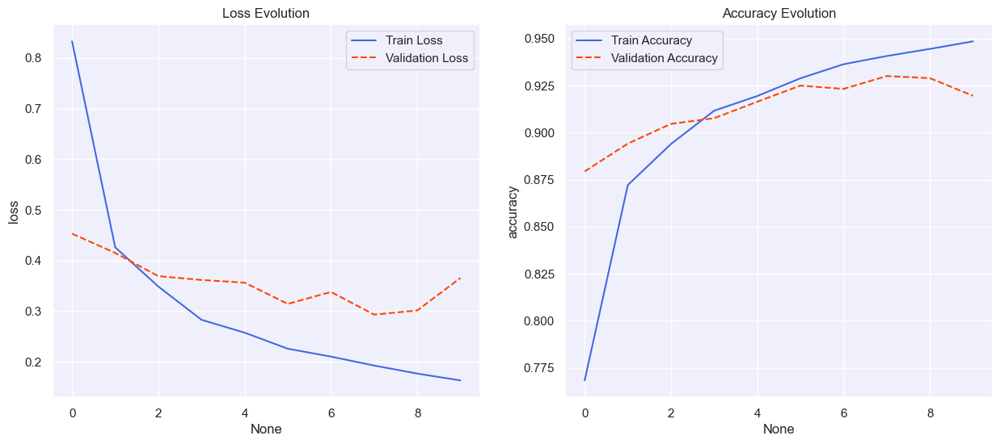

In [20]:
plot_learning_curves(history, 1)

In [26]:
weights_path_h5 = "model_weights.weights.h5"
transfer_resnet50_model.save_weights(weights_path_h5)
print(f"Model weights saved to {weights_path_h5}")

Model weights saved to model_weights.weights.h5


In [29]:
model_test_resnet_50 =  ResNet50(weights="model_weights.weights.h5", include_top=False, input_shape=(256, 256, 3))
model_test_resnet_50.summary()

Model: "resnet50"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2       │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, 262, 262,  │          0 │ input_layer_2[0]… │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 128, 128,  │      9,472 │ conv1_pad[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 128, 128,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 128, 128,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, 130, 130,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, 64, 64,    │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 64, 64,    │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 64, 64,    │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 64, 64,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 64, 64,    │     36,928 │ conv2_block1_1_r… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_bn   │ (None, 64, 64,    │        256 │ conv2_block1_2_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_relu │ (None, 64, 64,    │          0 │ conv2_block1_2_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_conv │ (None, 64, 64,    │     16,640 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_conv │ (None, 64, 64,    │     16,640 │ conv2_block1_2_r… │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 64, 64,    │      1,024 │ conv2_block1_0_c… │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_bn   │ (None, 64, 64,    │      1,024 │ conv2_block1_3_c

 Total params: 23,587,712 (89.98 MB)

 Trainable params: 23,534,592 (89.78 MB)

 Non-trainable params: 53,120 (207.50 KB)